Contents:
- [Animation](#animation)

- [Bayesian analysis](#bayesian-analysis)

In [2]:
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
from datetime import timedelta as delta
import datetime
import cartopy.crs as ccrs
import cartopy.feature as cfeature

from matplotlib.lines import Line2D
import matplotlib.cm  as cm
import matplotlib.animation as animation

Load the realease locations

In [3]:
river_sources = np.load('../river_sources.npy', allow_pickle=True).item()

I load the output files in a dictionary

In [4]:
simulations = {}

for loc in river_sources.keys():
    simulations[loc] = xr.load_dataset(f'../data/simulations/sa-s06/sa-s06-{loc}.nc')


In [6]:
simulations.keys()

dict_keys(['Congo', 'Cape-Town', 'Rio-de-la-Plata', 'Porto-Alegre', 'Santos', 'Paraiba', 'Itajai', 'Rio-de-Janeiro', 'Salvador', 'Recife'])

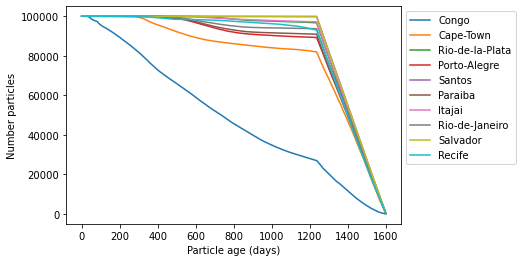

In [7]:
for loc in simulations.keys():
    plt.plot(100000 - np.sum(np.isnan(simulations[loc]['lat']), axis=0),
            label=loc)
plt.ylabel('Number particles')
plt.xlabel('Particle age (days)')
plt.legend(bbox_to_anchor=(1, 1))

> obs: there are 100K particles realesed but very few of them live more than a year, because the simulation goes until 1 and half year and then it stoped. Some particles exit the domain as well.

# Animation

In [8]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

Create the date range for real time animations

In [9]:
outputdt = delta(hours=24)
timerange = np.arange(np.nanmin(simulations['Rio-de-la-Plata']['time'].values),
                      np.nanmax(simulations['Rio-de-la-Plata']['time'].values) + np.timedelta64(outputdt), 
                      outputdt)

date_range = pd.date_range('2016-04-01', '2020-08-18') # easier to print dates.

In [16]:
sss = pd.date_range('2016-04-01', periods=1600, freq='D')

In [18]:
sss.shape

(1600,)

In [26]:
date_range[-1]

Timestamp('2020-08-18 00:00:00', freq='D')

### Real time animations

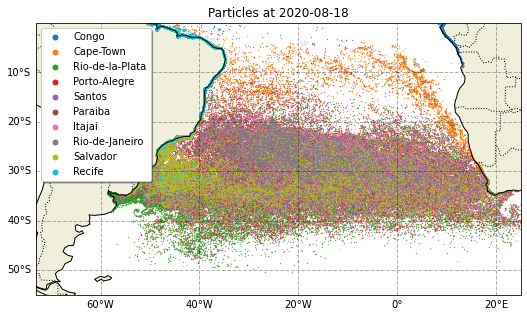

In [21]:
fig,ax = plt.subplots(figsize=(9,5),
                      subplot_kw={'projection': ccrs.PlateCarree()})

gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                  linewidth=1, color='black', alpha=0.3, linestyle='--')
gl.top_labels = False
gl.right_labels = False

t =1600
ax.set_extent([-73, 25,-55, 0], crs=ccrs.PlateCarree())

#ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)

ax.add_feature(cfeature.BORDERS, linestyle=':')

x_colors = np.linspace(0,1, 10)
colors = cm.get_cmap('tab10')(x_colors)

for j, loc in enumerate(river_sources.keys()):

    time_id = np.where(simulations[loc]['time'] == timerange[t])
    scatter = ax.scatter(simulations[loc]['lon'].values[time_id], simulations[loc]['lat'].values[time_id],
                     s=0.1, color=colors[j])
    
    
# I create the handles for the legend to get a bigger point that is visible.    
legend_elements = [Line2D([0], [0], marker='o', color='w',
                          label=loc, markersize=7,
                          markerfacecolor=colors[j]) for j,loc in enumerate(river_sources.keys())]

ax.legend(handles=legend_elements, shadow=True, loc='upper left')

date_str = str(date_range[t].date())
title = ax.set_title('Particles at '+ date_str)

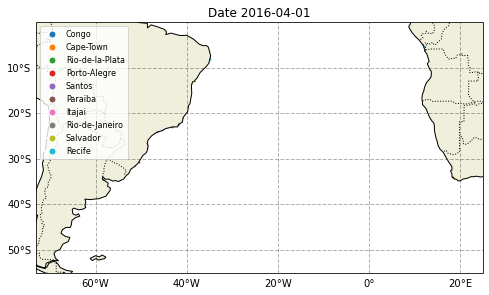

In [28]:
# real time


fig,ax = plt.subplots(figsize=(8,5),
                      subplot_kw={'projection': ccrs.PlateCarree()})

gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                  linewidth=1, color='black', alpha=0.3, linestyle='--')
gl.top_labels = False
gl.right_labels = False

ax.set_extent([-73, 25,-55, 0], crs=ccrs.PlateCarree())

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)

ax.add_feature(cfeature.BORDERS, linestyle=':')

x_colors = np.linspace(0,1, 10)
colors = cm.get_cmap('tab10')(x_colors)
handles = []

for j, loc in enumerate(river_sources.keys()):
    time_id = np.where(simulations[loc]['time'] == timerange[0])
    scatter = ax.scatter(simulations[loc]['lon'].values[time_id],
                         simulations[loc]['lat'].values[time_id],
                         s=0.1, color=colors[j])
    handles.append(scatter)

    
    
legend_elements = [Line2D([0], [0], marker='o', color='w',
                          label=loc, markersize=7,
                          markerfacecolor=colors[j]) for j,loc in enumerate(river_sources.keys())]

ax.legend(handles=legend_elements, loc='upper left', fontsize=8)

date_str = str(date_range[0].date())
title = ax.set_title(f'Date {date_str}')

def animate_realtime(i):
    date_str = str(date_range[i].date())
    title = ax.set_title(f'Date {date_str}')
    
    for j, loc in enumerate(river_sources.keys()):
        time_id = np.where(simulations[loc]['time'] == timerange[i])
        handles[j].set_offsets(np.c_[simulations[loc]['lon'].values[time_id],
                                     simulations[loc]['lat'].values[time_id]])
            
    
anim_realtime = FuncAnimation(fig, animate_realtime, frames=1600, interval=500)

In [23]:
#HTML(anim_realtime.to_jshtml())

This is the Writer to save the animation to mp4. 

In [ ]:
# Set up formatting for the movie files
Writer = animation.writers['ffmpeg']
writer = Writer(fps=30, metadata=dict(artist='Claudio'), bitrate=5000)

anim_realtime.save(f'../animations/realtime_sa-s06.mp4', writer=writer, dpi=100)

### Particle age

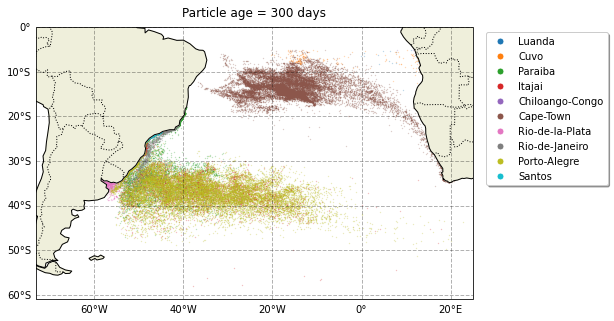

In [366]:
fig,ax = plt.subplots(figsize=(9,5),
                      subplot_kw={'projection': ccrs.PlateCarree()})

gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                  linewidth=1, color='black', alpha=0.3, linestyle='--')
gl.top_labels = False
gl.right_labels = False

t = 300
ax.set_extent([-73.0, 24.916666,-60.916664, 0.0833335], crs=ccrs.PlateCarree())

#ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.LAND, zorder=1)
ax.add_feature(cfeature.COASTLINE)

ax.add_feature(cfeature.BORDERS, linestyle=':')

x_colors = np.linspace(0,1, 10)
colors = cm.get_cmap('tab10')(x_colors)

for j, loc in enumerate(river_sources.keys()):
    
    scatter = ax.scatter(simulations[loc]['lon'].values[:, t],
                         simulations[loc]['lat'].values[:, t],
                     s=0.1, color=colors[j], alpha=0.4)
    
legend_elements = [Line2D([0], [0], marker='o', color='w',
                          label=loc, markersize=7,
                          markerfacecolor=colors[j]) for j,loc in enumerate(river_sources.keys())]

ax.legend(handles=legend_elements, shadow=True, loc='upper left', bbox_to_anchor=(1.02, 1))

date_str = str(date_range[t].date())
title = ax.set_title(f'Particle age = {t} days')

In [452]:
%%capture

fig,ax = plt.subplots(figsize=(10,5),
                      subplot_kw={'projection': ccrs.PlateCarree()})

gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                  linewidth=1, color='black', alpha=0.3, linestyle='--')
gl.top_labels = False
gl.right_labels = False

t = 300
ax.set_extent([-73.0, 24.916666,-60.916664, 0.0833335], crs=ccrs.PlateCarree())

#ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)

ax.add_feature(cfeature.BORDERS, linestyle=':')

x_colors = np.linspace(0,1, 10)
colors = cm.get_cmap('tab10')(x_colors)
handles = []

for j, loc in enumerate(river_sources.keys()):
    
    scatter = ax.scatter(simulations[loc]['lon'].values[:, 0],
                         simulations[loc]['lat'].values[:, 0],
                     s=0.1, color=colors[j], alpha=0.4)
    handles.append(scatter)
    
legend_elements = [Line2D([0], [0], marker='o', color='w',
                          label=loc, markersize=7,
                          markerfacecolor=colors[j]) for j,loc in enumerate(river_sources.keys())]

ax.legend(handles=legend_elements, shadow=True, loc='upper left', bbox_to_anchor=(1.01, 1))

# date_str = str(date_range[t].date())
title = ax.set_title(f'Particle age = {0} days')

def animate_age(i):
    title.set_text(f'Particle age = {i} days')
    
    for j, loc in enumerate(river_sources.keys()):
        handles[j].set_offsets(np.c_[simulations[loc]['lon'].values[:, i],
                                     simulations[loc]['lat'].values[:, i]])
    
    
anim_age = FuncAnimation(fig, animate_age, frames = 370, interval=500)

In [453]:
HTML(anim_age.to_jshtml())

Animation size has reached 21017405 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [454]:
anim_age.save('../presentation/images/age_animation.mp4', writer=writer, dpi=100)